In [21]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

import glob
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation

In [ ]:
def extract_features(image):
    # Use ORB (Oriented FAST and Rotated BRIEF) for feature extraction
    orb = cv.ORB_create()
    keypoints, descriptors = orb.detectAndCompute(image, None)
    return keypoints, descriptors


def match_features(desc1, desc2):
    # Use BFMatcher (Brute Force Matcher) with Hamming distance for ORB
    bf = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)
    matches = bf.match(desc1, desc2)
    matches = sorted(matches, key=lambda x: x.distance)
    return matches


def estimate_motion(kp1, kp2, matches, K):
    # Extract the matched keypoints
    pts1 = np.float32([kp1[m.queryIdx].pt for m in matches])
    pts2 = np.float32([kp2[m.trainIdx].pt for m in matches])

    # Estimate the Essential matrix
    E, _ = cv.findEssentialMat(pts1, pts2, K, method=cv.RANSAC, prob=0.999, threshold=1.0)

    # Recover the relative camera rotation and translation
    _, R, t, _ = cv.recoverPose(E, pts1, pts2, K)
    return R, t


def build_trajectory(images, K):
    # Assume the first camera pose is at the origin
    trajectory = [np.eye(4)]

    for i in range(1, len(images)):
        # Extract features
        kp1, desc1 = extract_features(images[i-1])
        kp2, desc2 = extract_features(images[i])

        # Match features
        matches = match_features(desc1, desc2)

        # Estimate motion
        R, t = estimate_motion(kp1, kp2, matches, K)

        # Construct the transformation matrix
        T = np.eye(4)
        T[:3, :3] = R
        T[:3, 3] = t.flatten()

        # Compute the new camera pose
        new_pose = trajectory[-1] @ np.linalg.inv(T)
        trajectory.append(new_pose)

    return trajectory


def main():
    # Load your images
    images = [cv.imread(f'image_{i}.png', 0) for i in range(1, 6)]

    # Camera intrinsic matrix K (you should replace this with your camera's intrinsic parameters)
    K = np.array([[718.8560, 0, 607.1928],
                  [0, 718.8560, 185.2157],
                  [0, 0, 1]])

    # Build the trajectory
    trajectory = build_trajectory(images, K)

    # Print the camera poses
    for i, pose in enumerate(trajectory):
        print(f"Pose {i}:\n{pose}\n")

if __name__ == "__main__":
    main()
'''
Notes:
Camera Intrinsics (K): The intrinsic matrix K depends on your camera and should be calibrated beforehand.
Feature Matching: Matching can be tuned or replaced with more robust methods like FLANN-based matching.
Motion Estimation: The essential matrix estimation assumes a pinhole camera model and requires calibrated intrinsics.
Conclusion
This code provides
'''

error: OpenCV(4.10.0) /io/opencv/modules/calib3d/src/five-point.cpp:458: error: (-215:Assertion failed) npoints >= 0 && points2.checkVector(2) == npoints && points1.type() == points2.type() in function 'findEssentialMat'


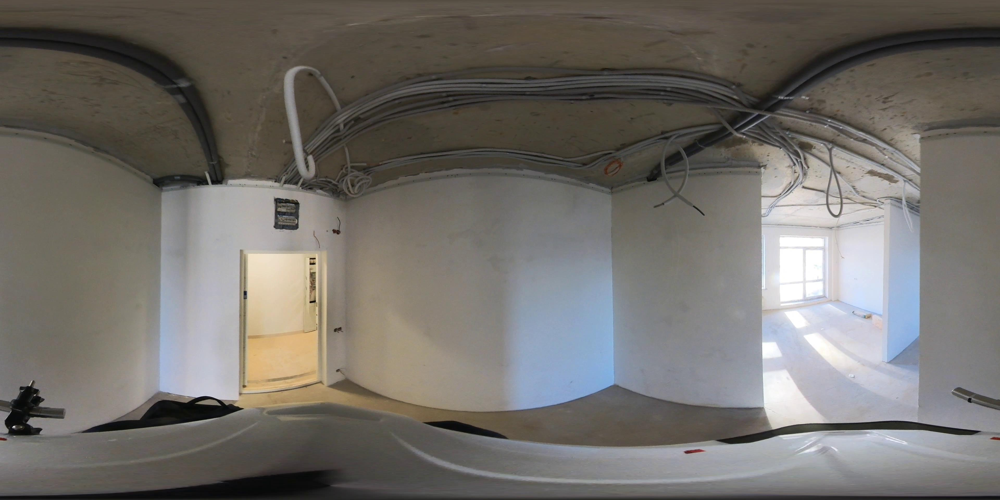

In [4]:
img1 = cv.imread('frame0000250.jpg')
img2 = cv.imread('frame0000251.jpg')

cv2_imshow(img1)

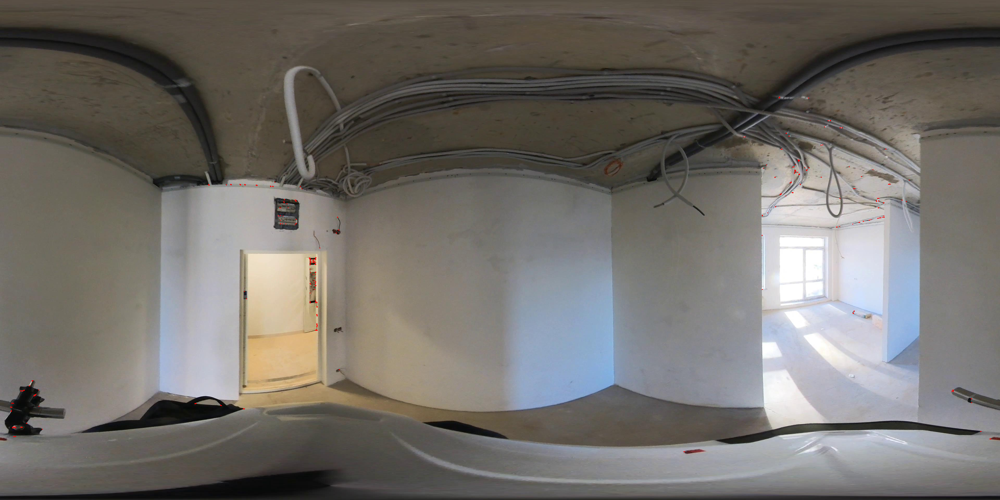

In [3]:
operatedImage = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
operatedImage = np.float32(operatedImage)

dest = cv.cornerHarris(operatedImage, 2, 5, 0.07)
dest = cv.dilate(dest, None)

img1[dest > 0.01 * dest.max()] = [0, 0, 255]

cv2_imshow(img1)
cv.waitKey(0)
cv.destroyAllWindows()

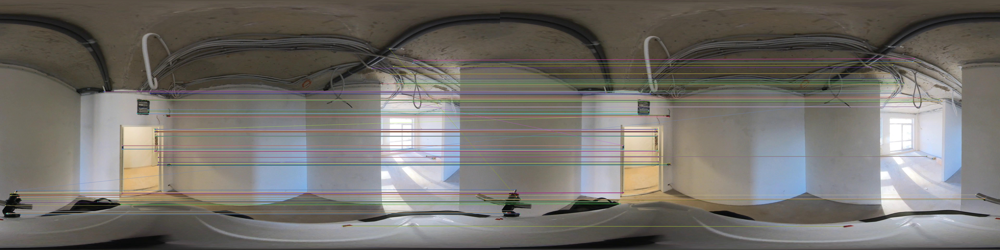

In [25]:
orb = cv.ORB_create()

kp1, des1 = orb.detectAndCompute(img1, None)
kp2, des2 = orb.detectAndCompute(img2, None)

bf = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)

result = cv.drawMatches(img1, kp1, img2, kp2, matches, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

cv2_imshow(result)
cv.waitKey(0)
cv.destroyAllWindows()

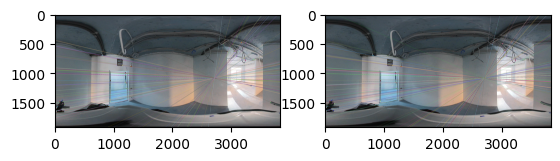

In [30]:
# FLANN параметры
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=50)

flann = cv.FlannBasedMatcher(index_params,search_params)
matches = flann.knnMatch(np.float32(des1),np.float32(des2),k=2) #matches = flann.knnMatch(des1,des2,k=2)

pts1 = []
pts2 = []

for i,(m,n) in enumerate(matches):
    if m.distance < 0.8*n.distance:
      pts2.append(kp2[m.trainIdx].pt)
      pts1.append(kp1[m.queryIdx].pt)

pts1 = np.int32(pts1)
pts2 = np.int32(pts2)
F, mask = cv.findFundamentalMat(pts1,pts2,cv.FM_LMEDS)

pts1 = pts1[mask.ravel()==1]
pts2 = pts2[mask.ravel()==1]

def drawlines(img1,img2,lines,pts1,pts2):
  r,c,_ = img1.shape
  #img1 = cv.cvtColor(img1,cv.COLOR_GRAY2BGR)
  #img2 = cv.cvtColor(img2,cv.COLOR_GRAY2BGR)
  for r,pt1,pt2 in zip(lines,pts1,pts2):
      color = tuple(np.random.randint(0,255,3).tolist())
      x0,y0 = map(int, [0, -r[2]/r[1] ])
      x1,y1 = map(int, [c, -(r[2]+r[0]*c)/r[1] ])
      img1 = cv.line(img1, (x0,y0), (x1,y1), color,1)
      img1 = cv.circle(img1,tuple(pt1),5,color,-1)
      img2 = cv.circle(img2,tuple(pt2),5,color,-1)
  return img1,img2

# Поиск и черчение точек второй фотки на первой фотке
lines1 = cv.computeCorrespondEpilines(pts2.reshape(-1,1,2), 2,F)
lines1 = lines1.reshape(-1,3)
img5,img6 = drawlines(img1,img2,lines1,pts1,pts2)

# наоборот
lines2 = cv.computeCorrespondEpilines(pts1.reshape(-1,1,2), 1,F)
lines2 = lines2.reshape(-1,3)
img3,img4 = drawlines(img2,img1,lines2,pts2,pts1)

plt.subplot(121),plt.imshow(img5)
plt.subplot(122),plt.imshow(img3)
plt.show()

In [20]:
# Функция для нахождения ключевых точек и описаний
def find_keypoints_and_descriptors(img):
    # Используем алгоритм SURF для нахождения ключевых точек
    detector = cv.ORB_create()
    keypoints, descriptors = detector.detectAndCompute(img, None)
    return keypoints, descriptors

# Функция для сопоставления ключевых точек между двумя изображениями
def match_keypoints(kp1, des1, kp2, des2):
    # Создаём FlannBasedMatcher для быстрого сопоставления
    matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)#matcher.knnMatch(des1, des2, k=2)
    good_matches = []
    for m, n in matches:
        if m.distance < 0.7  *  n.distance:
            good_matches.append(m)
    return good_matches

# Функция для вычисления геометрии камеры
def compute_camera_geometry(kp1, kp2, matches):
    # Извлекаем координаты ключевых точек
    pts1 = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    pts2 = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

    # Вычисляем геометрию камеры
    F, mask = cv.findFundamentalMat(pts1, pts2, cv.FM_RANSAC, 5.0, 0.99)
    E, mask = cv.recoverPose(F, pts1, pts2)
    R, t = cv.Rodrigues(E)[0]
    return R, t

# Функция для восстановления трёхмерной структуры сцены
def reconstruct_scene(Rs, ts, kps, img_size):
    # Восстанавливаем трёхмерные координаты ключевых точек
    points3D = []
    points2D = []
    for i, (kp, (R, t)) in enumerate(zip(kps, zip(Rs, ts))):
        points2D.append(np.array([kp[m.queryIdx].pt for m in good_matches]))
        points3D.append(cv.triangulatePoints(R, t, points2D[-1], np.zeros((1, 4)))[0])

    # Нормализуем координаты
    min_x = min([p[0] for p in points3D])
    max_x = max([p[0] for p in points3D])
    min_y = min([p[1] for p in points3D])
    max_y = max([p[1] for p in points3D])
    min_z = min([p[2] for p in points3D])
    max_z = max([p[2] for p in points3D])

    scale = max(max_x - min_x, max_y - min_y, max_z - min_z)
    points3D = [(p[0] - min_x) / scale, (p[1] - min_y) / scale, (p[2] - min_z) / scale]

    # Переводим в систему координат, где z направлен вверх
    points3D = np.array(points3D).T
    rotation = Rotation.from_euler('xyz', [0, 0, np.pi], degrees=True).as_matrix()
    points3D = points3D @ rotation

    return points3D

# Функция для визуализации трёхмерного пространства
def visualize_3d_space(points3D):
    from mpl_toolkits.mplot3d import Axes3D
    import matplotlib.pyplot as plt

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter( * points3D)
    plt.show()

In [21]:
# Нахождение ключевых точек и описаний
kp1, des1 = find_keypoints_and_descriptors(img1)
kp2, des2 = find_keypoints_and_descriptors(img2)

# Сопоставление ключевых точек
good_matches = match_keypoints(kp1, des1, kp2, des2)

# Вычисление геометрии камеры
R, t = compute_camera_geometry(kp1, kp2, good_matches)

# Восстановление трёхмерной структуры сцены
points3D = reconstruct_scene([R], [t], [kp1], img1.shape)

# Визуализация трёхмерного пространства
visualize_3d_space(points3D)

TypeError: cannot unpack non-iterable cv2.DMatch object

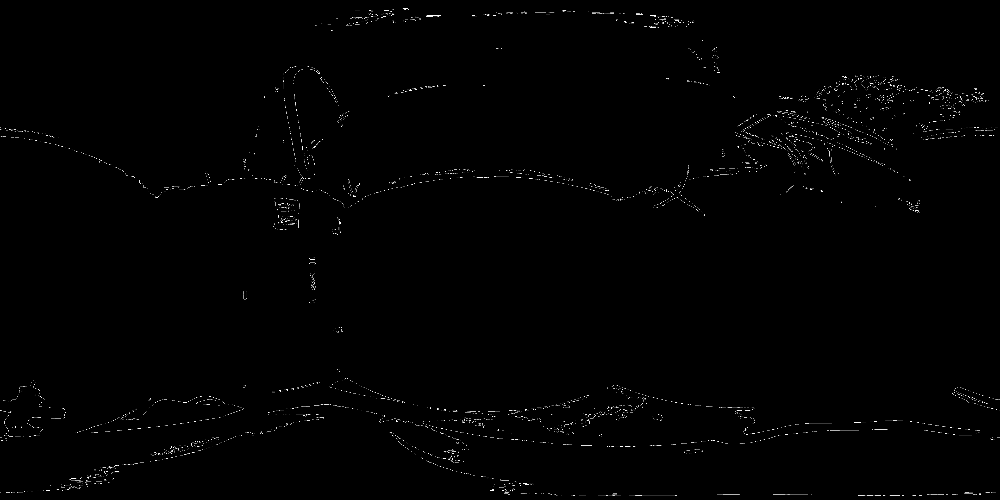

In [18]:
median_image  = cv.medianBlur(img1,5)
img_grey = cv.cvtColor(median_image,cv.COLOR_BGR2GRAY) #img_grey = cv.cvtColor(img1,cv.COLOR_BGR2GRAY)

#зададим порог
thresh = 90

#получим картинку, обрезанную порогом
ret,thresh_img = cv.threshold(img_grey, thresh, 255, cv.THRESH_BINARY)

#надем контуры
contours, hierarchy = cv.findContours(thresh_img, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

#создадим пустую картинку
img_contours = np.zeros(img1.shape)

#отобразим контуры
cv.drawContours(img_contours, contours, -1, (255,255,255), 1)

cv2_imshow(img_contours) # выводим итоговое изображение в окно

cv.waitKey()
cv.destroyAllWindows()

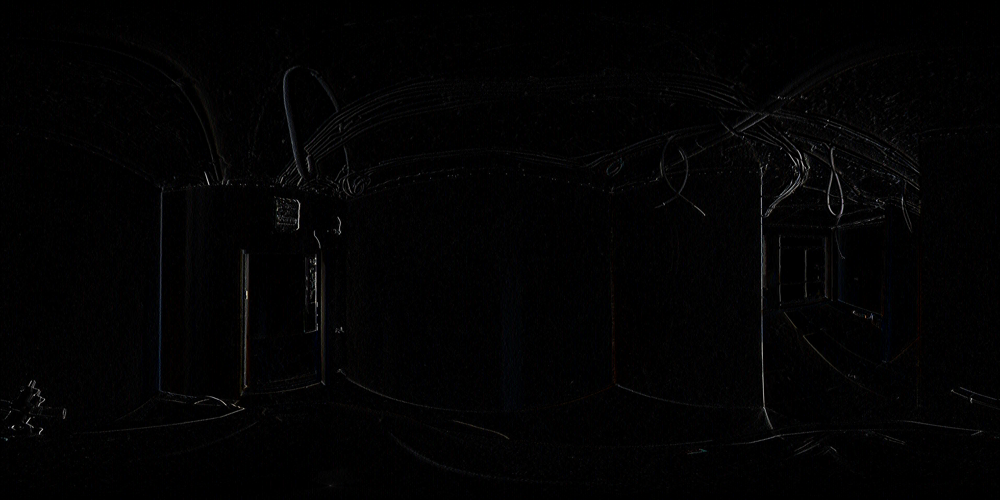

In [20]:
#kernel = np.array([[-1,0,1], [-2,0,2], [-1,0,1]])
laplas = np.array([[0,1,0], [1,-4,1], [0,1,0]])
im = cv.filter2D(img1, -1, laplas)
cv2_imshow(im)
cv.waitKey(0)
cv.destroyAllWindows()